# Loading the libraries

In [28]:
from tensorflow.keras.models import load_model
import os
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import cv2

In [29]:
model = load_model("D:\Multi-Class-Image-Segmentation\segment_weights.h5")

In [30]:
# Specify the directory of images for performing segmentation
Prediction_Directory = 'D:\Multi-Class-Image-Segmentation\Prediction'
# Check the number of images in the directory
prediction_paths = []
for i in os.listdir(Prediction_Directory):
  img = os.path.join(Prediction_Directory, i)
  prediction_paths.append(img)
print('Number of images in the Prediction folder: {} \n'.format(len(prediction_paths)))
prediction_paths.sort()

Number of images in the Prediction folder: 40 



## Loading the colormap

In [31]:
# Loading the Colormap
colormap = loadmat(
    "D:/Multi-Class-Image-Segmentation/human_colormap.mat"
)["colormap"]
colormap = colormap * 100
colormap = colormap.astype(np.uint8)


In [32]:
def get_overlay(image, colored_mask):
    image = tf.keras.preprocessing.image.array_to_img(image)
    image = np.array(image).astype(np.uint8)
    overlay = cv2.addWeighted(image, 0.35, colored_mask, 0.65, 0)
    return overlay

In [33]:
IMAGE_SIZE =512
# Helper functions
def infer(model, image_tensor):
    predictions = model.predict(np.expand_dims((image_tensor), axis=0))
    predictions = np.squeeze(predictions)
    predictions = np.argmax(predictions, axis=2)
    return predictions

def decode_segmentation_masks(mask, colormap, n_classes):
    r = np.zeros_like(mask).astype(np.uint8)
    g = np.zeros_like(mask).astype(np.uint8)
    b = np.zeros_like(mask).astype(np.uint8)
    for l in range(0, n_classes):
        idx = mask == l
        r[idx] = colormap[l, 0]
        g[idx] = colormap[l, 1]
        b[idx] = colormap[l, 2]
    rgb = np.stack([r, g, b], axis=2)
    return rgb

def read_image(image_path, mask=False):
    image = tf.io.read_file(image_path)
    if mask:
        image = tf.image.decode_png(image, channels=1)
        image.set_shape([None, None, 1])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf.image.decode_png(image, channels=3)
        image.set_shape([None, None, 3])
        image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
        image = image / 127.5 - 1
    return image
def plot_samples_matplotlib(display_list, figsize=(5, 3)):
    _, axes = plt.subplots(nrows=1, ncols=len(display_list), figsize=figsize)
    for i in range(len(display_list)):
        if display_list[i].shape[-1] == 3:
            axes[i].imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        else:
            axes[i].imshow(display_list[i])
    plt.show()

In [34]:
def plot_predictions(images_list, colormap, model):
    for image_file in images_list:
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, 20)
        overlay = get_overlay(image_tensor, prediction_colormap)
        plot_samples_matplotlib(
            [image_tensor, overlay, prediction_colormap], figsize=(18, 14)
        )


1/1 [==============================] - 3s 3s/step


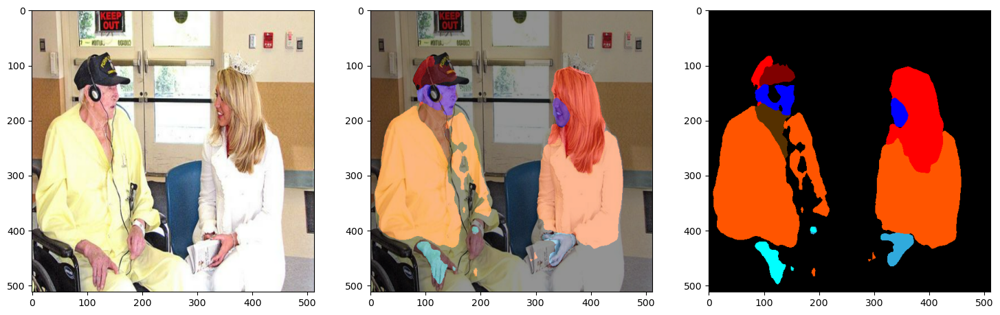

1/1 [==============================] - 1s 768ms/step


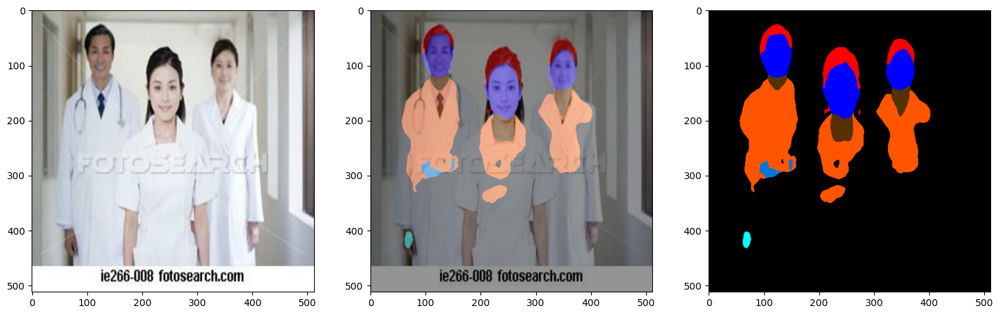

1/1 [==============================] - 1s 758ms/step


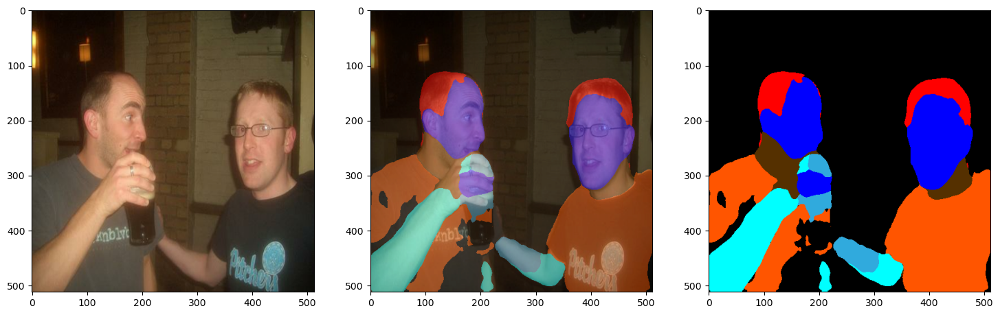

1/1 [==============================] - 1s 814ms/step


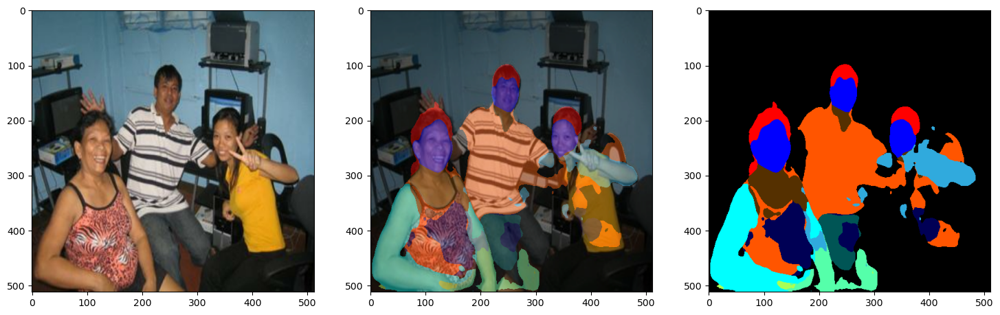

1/1 [==============================] - 1s 787ms/step


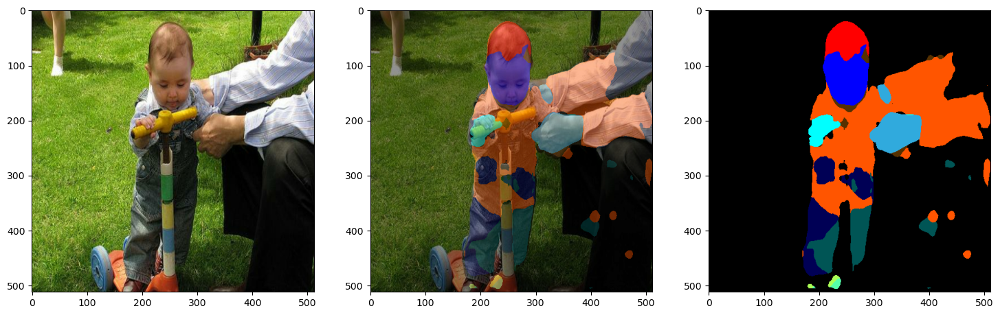

1/1 [==============================] - 1s 751ms/step


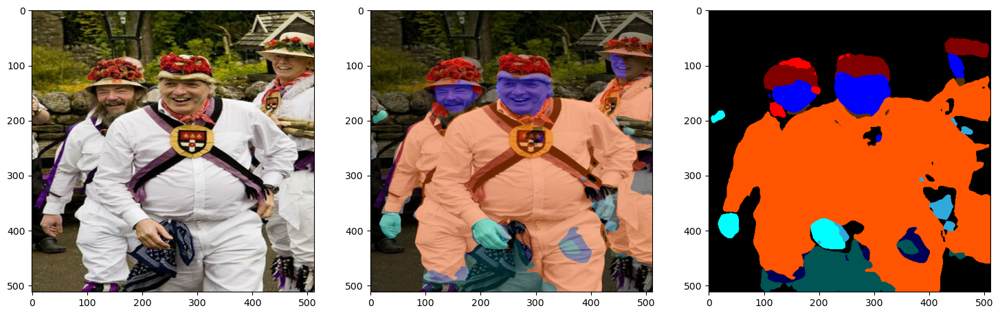

1/1 [==============================] - 1s 770ms/step


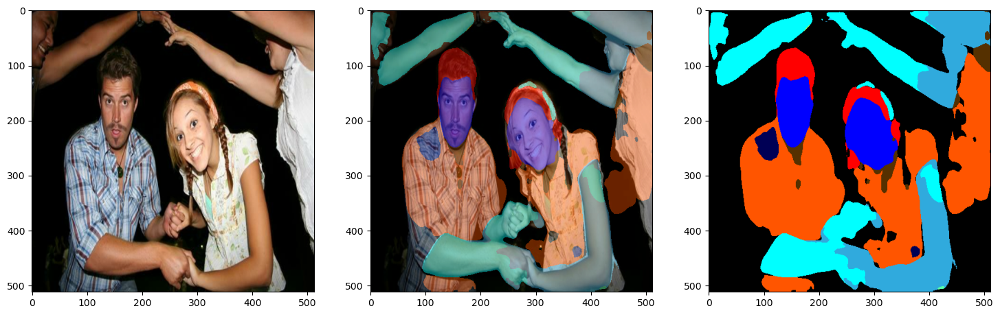

1/1 [==============================] - 1s 837ms/step


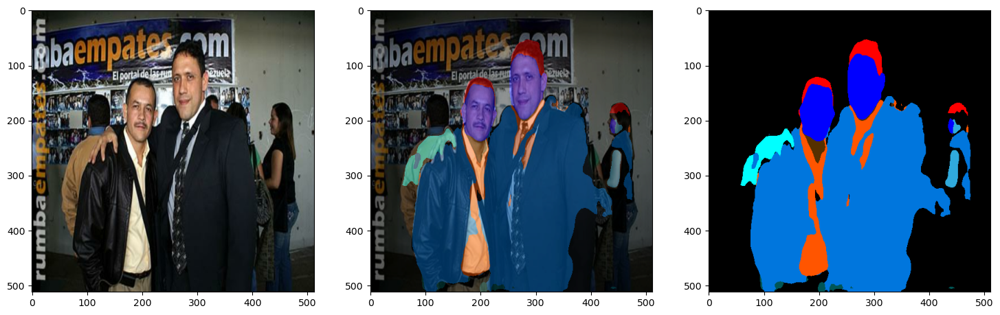

1/1 [==============================] - 1s 973ms/step


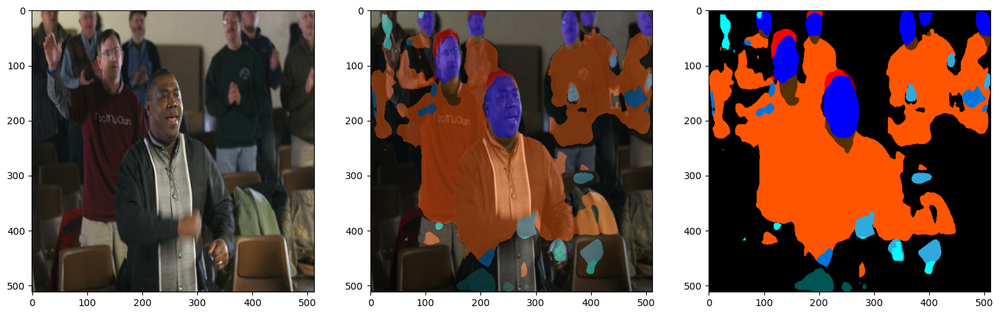

1/1 [==============================] - 1s 812ms/step


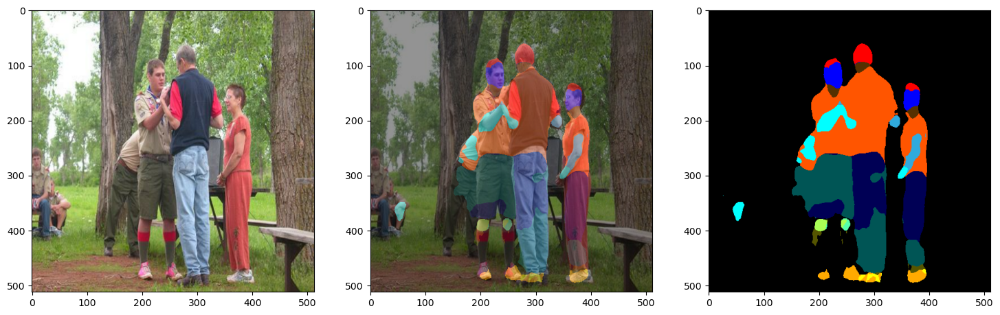

1/1 [==============================] - 1s 797ms/step


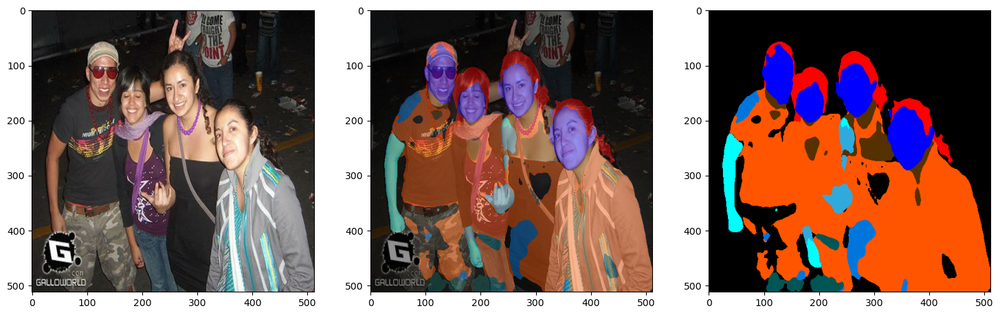

1/1 [==============================] - 1s 807ms/step


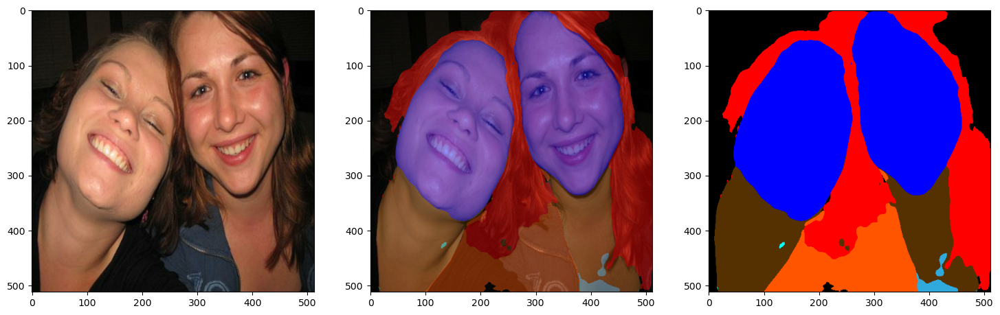

1/1 [==============================] - 1s 824ms/step


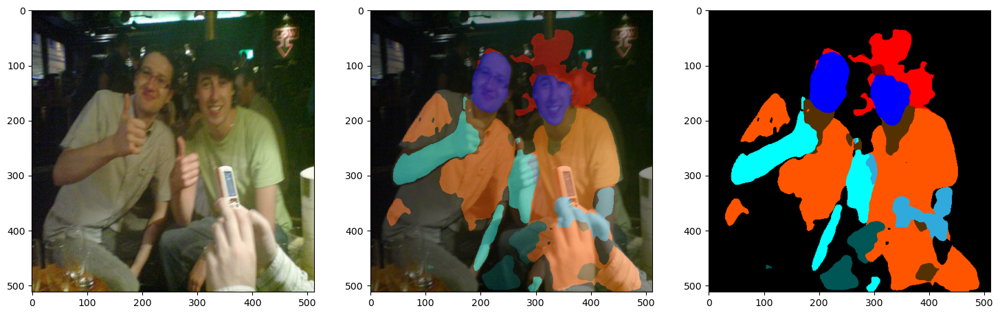

1/1 [==============================] - 1s 821ms/step


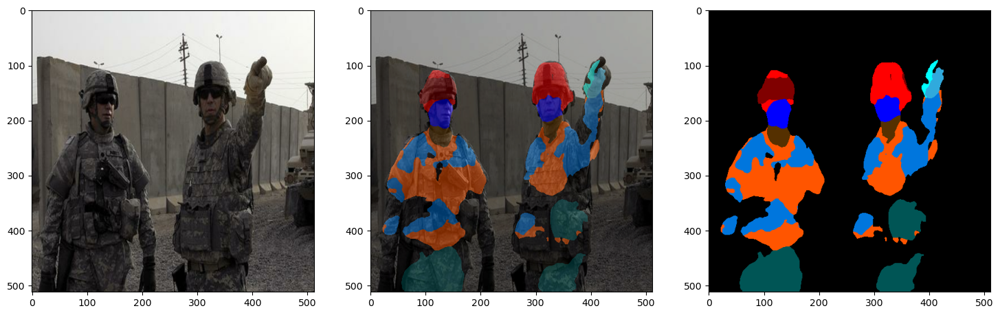

1/1 [==============================] - 1s 984ms/step


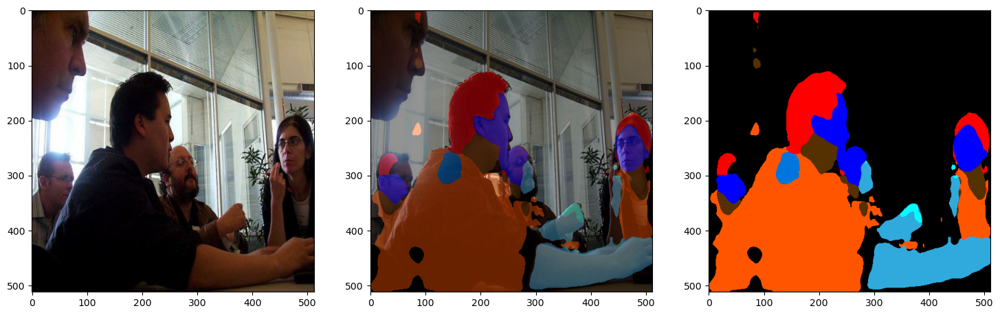

1/1 [==============================] - 1s 872ms/step


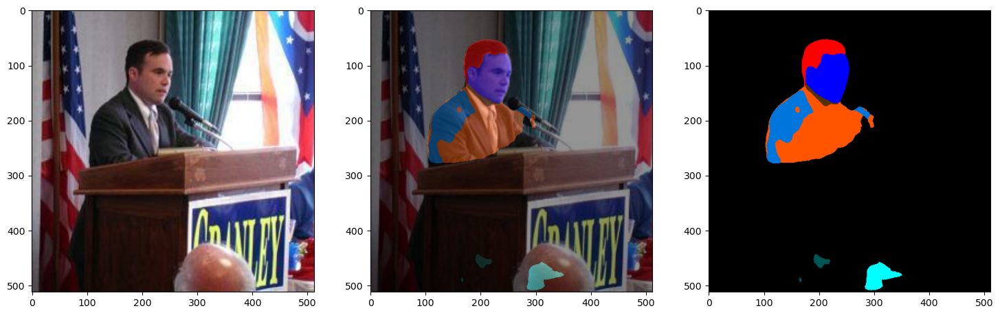

1/1 [==============================] - 1s 852ms/step


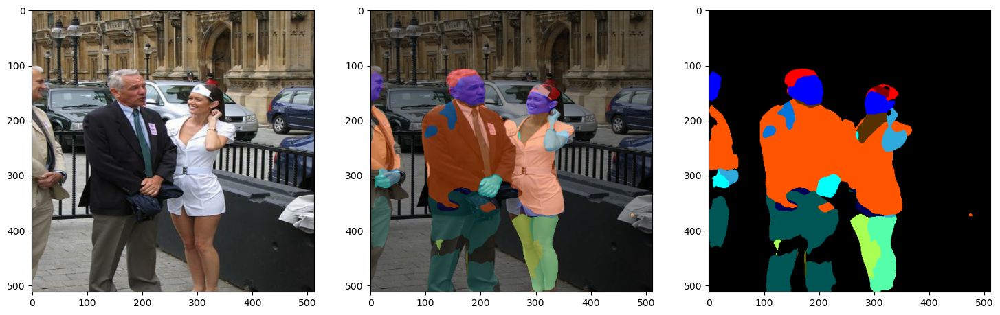

1/1 [==============================] - 1s 895ms/step


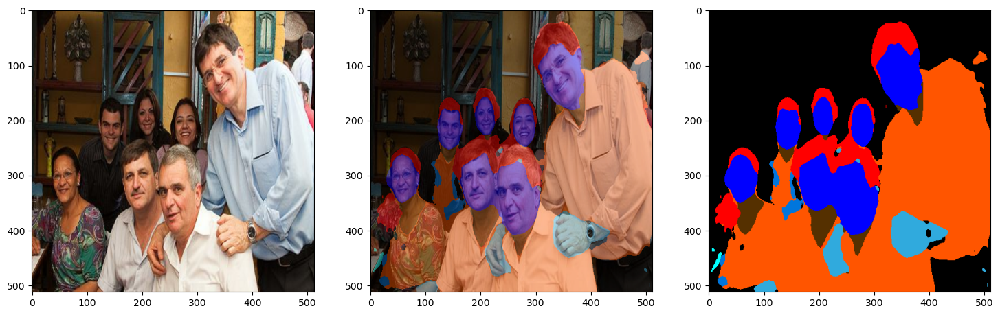

1/1 [==============================] - 1s 842ms/step


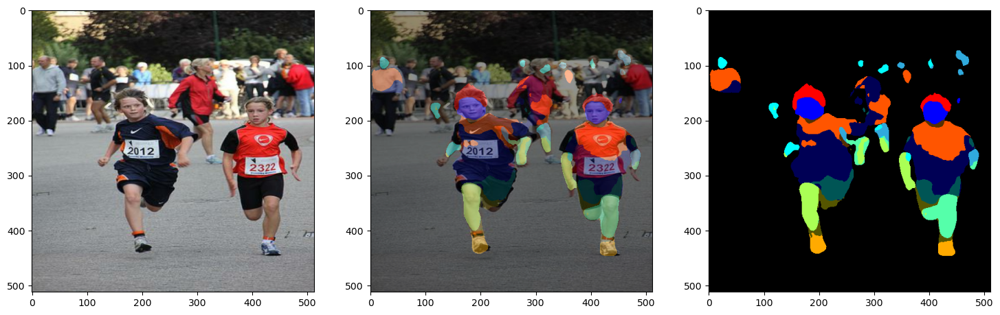

1/1 [==============================] - 1s 850ms/step


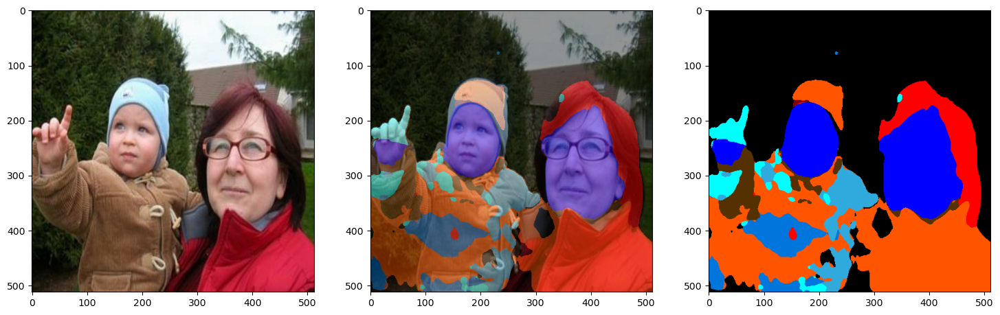

1/1 [==============================] - 1s 886ms/step


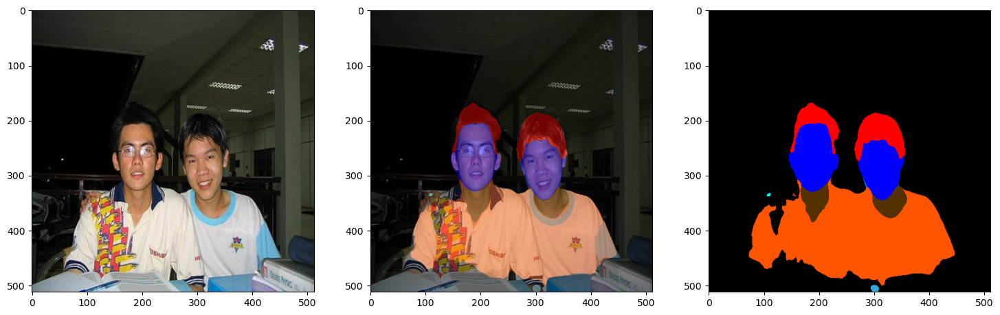

1/1 [==============================] - 1s 884ms/step


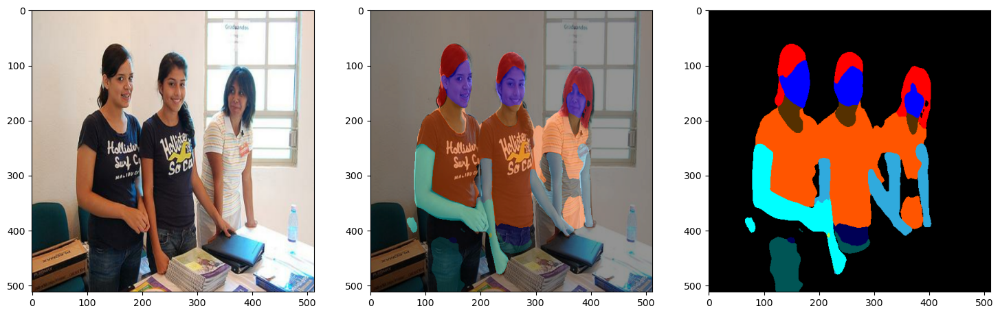

1/1 [==============================] - 1s 871ms/step


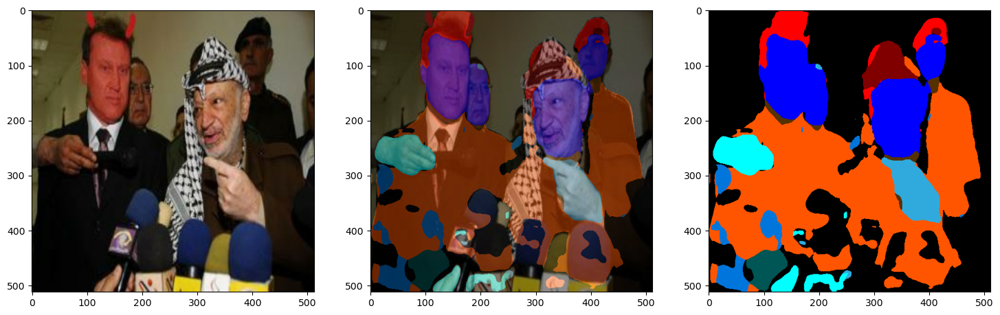

1/1 [==============================] - 1s 886ms/step


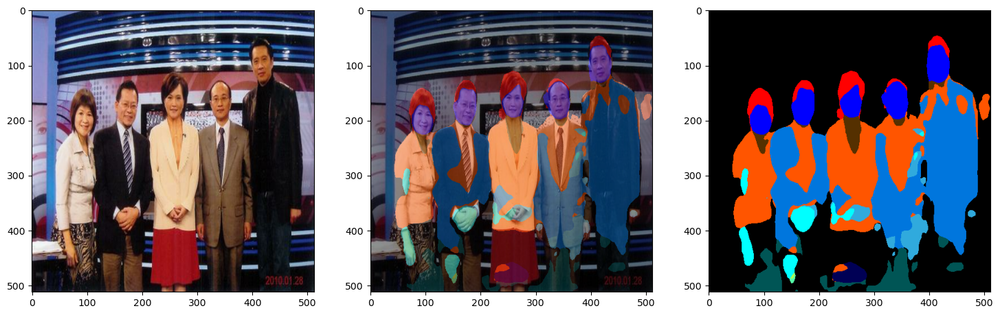

1/1 [==============================] - 1s 787ms/step


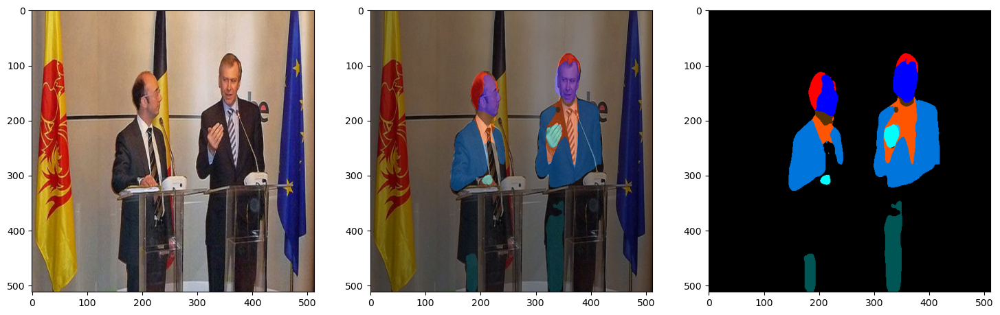

1/1 [==============================] - 1s 862ms/step


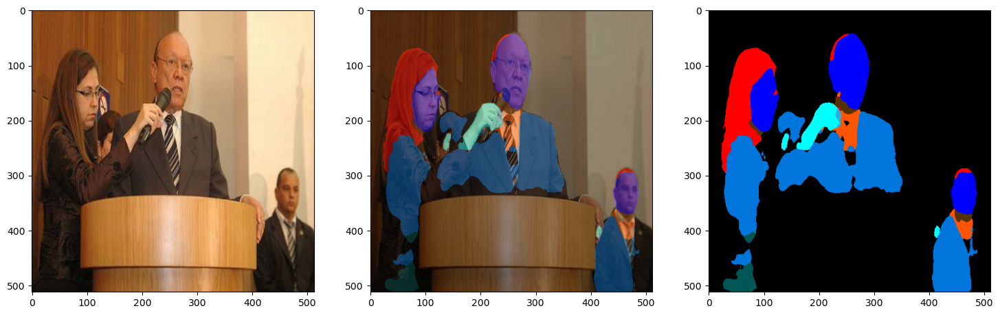

1/1 [==============================] - 1s 900ms/step


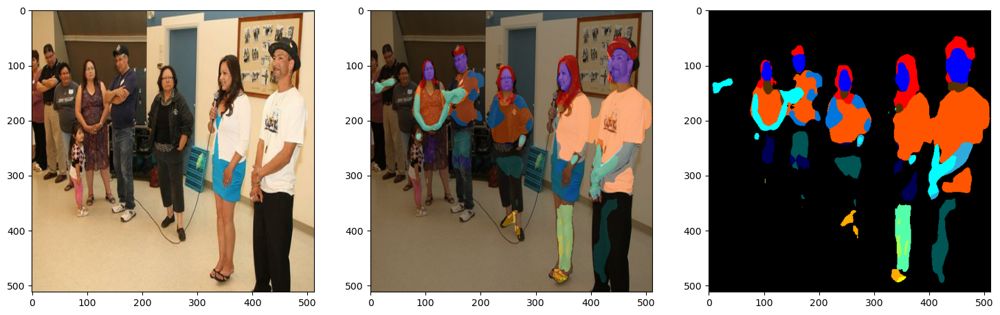

1/1 [==============================] - 1s 886ms/step


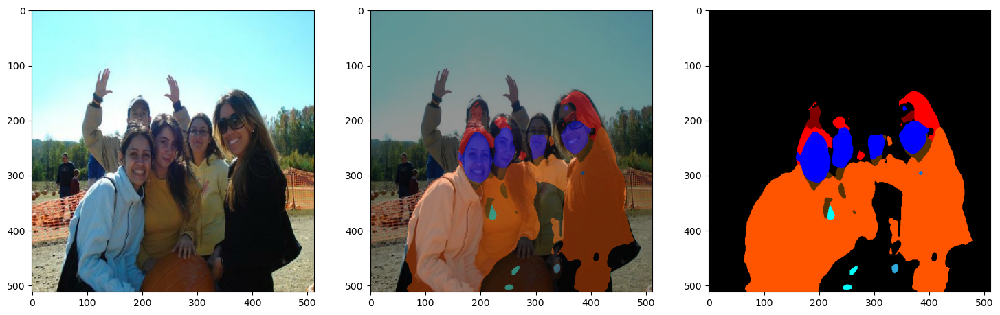

1/1 [==============================] - 1s 917ms/step


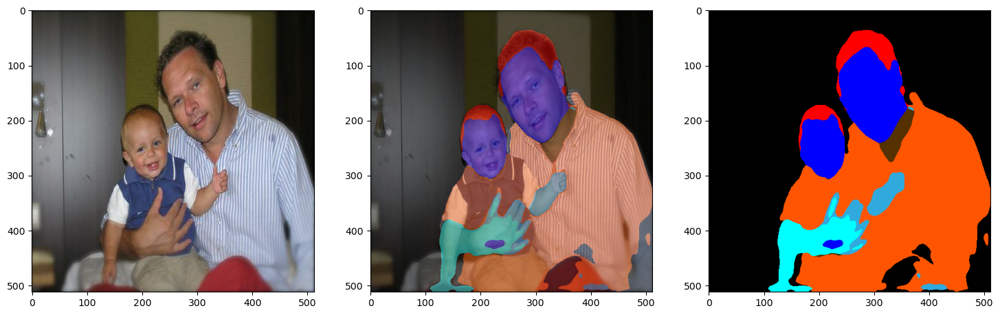

1/1 [==============================] - 1s 903ms/step


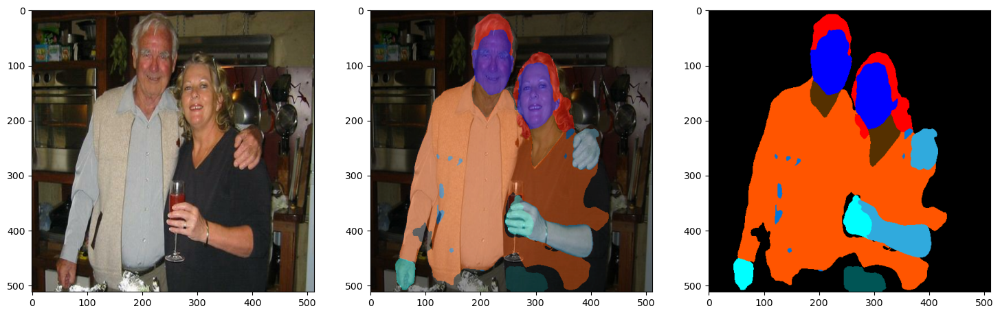

1/1 [==============================] - 1s 858ms/step


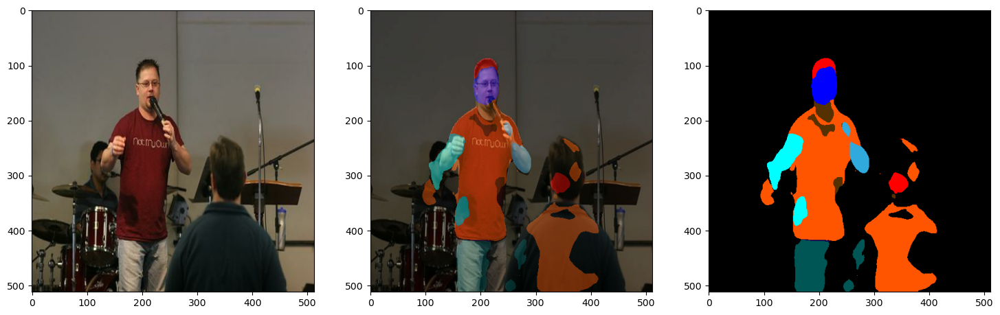

1/1 [==============================] - 1s 887ms/step


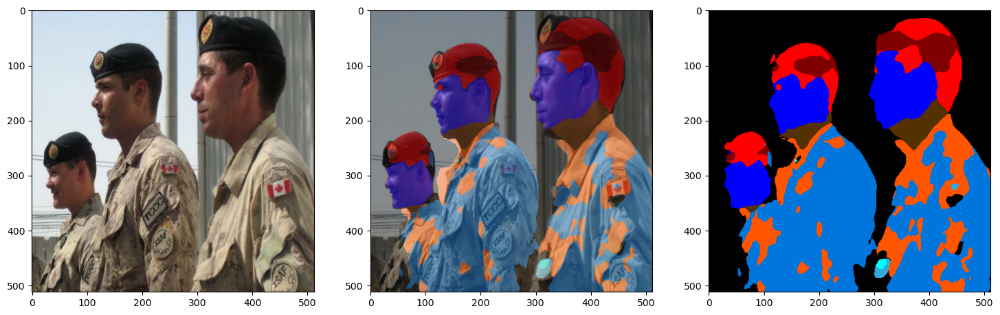

1/1 [==============================] - 1s 902ms/step


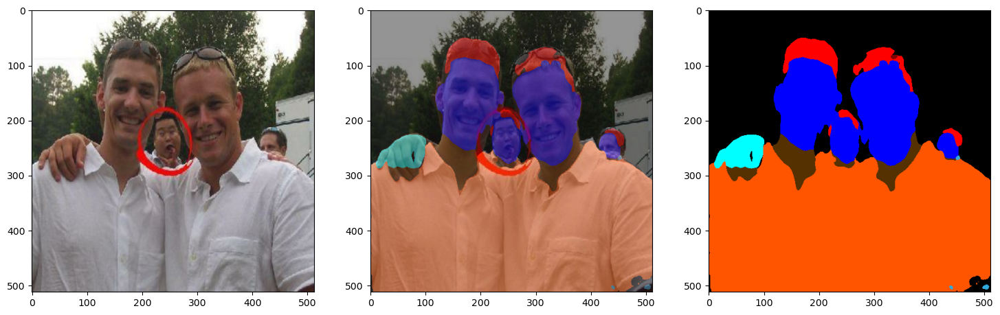

1/1 [==============================] - 1s 869ms/step


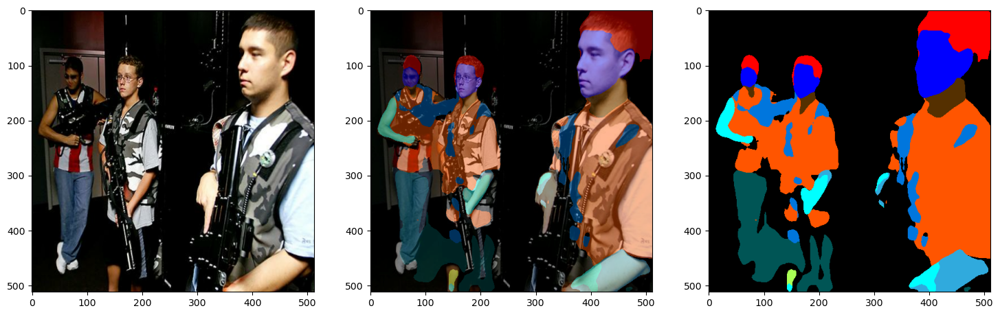

1/1 [==============================] - 1s 846ms/step


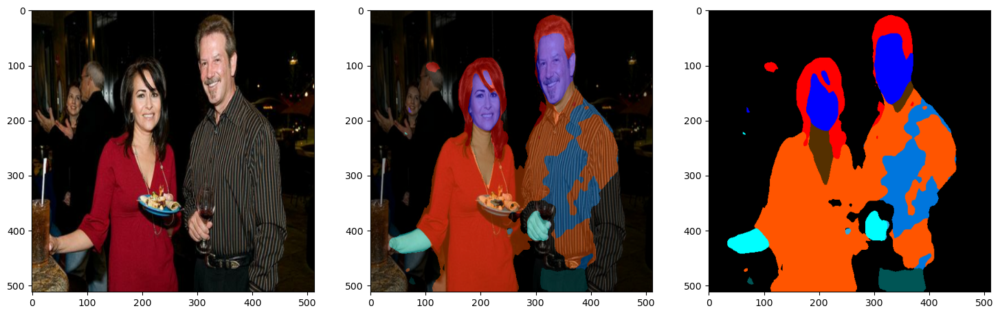

1/1 [==============================] - 1s 846ms/step


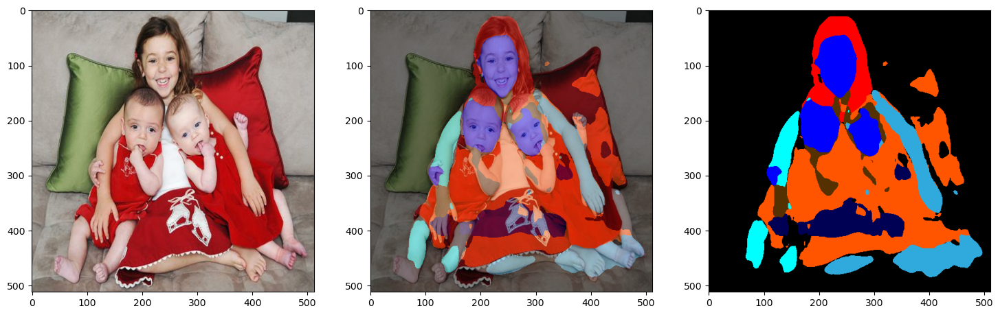

1/1 [==============================] - 1s 847ms/step


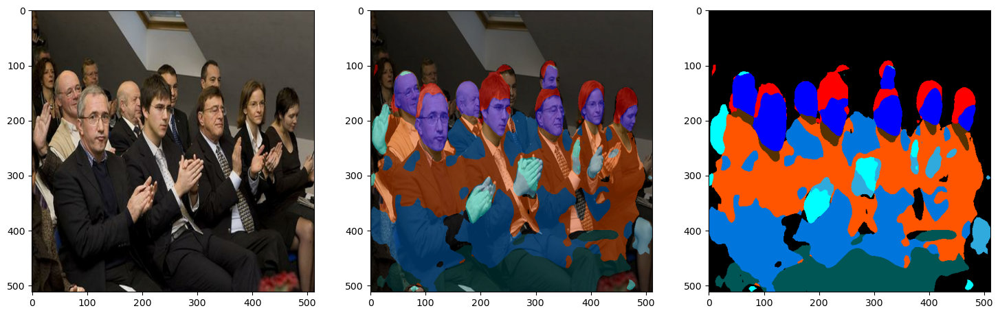

1/1 [==============================] - 1s 811ms/step


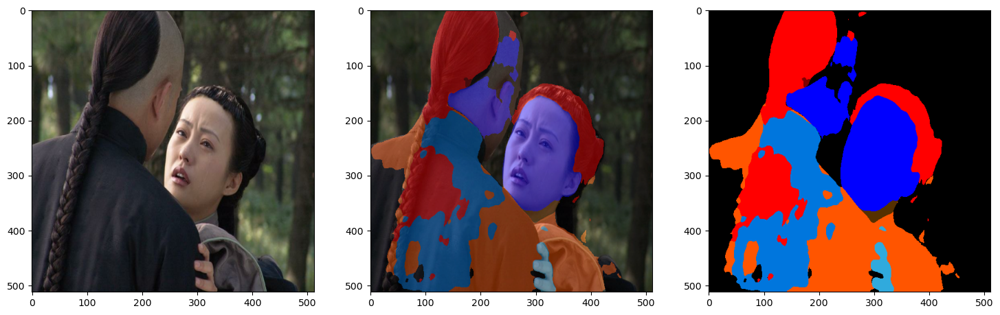

1/1 [==============================] - 1s 844ms/step


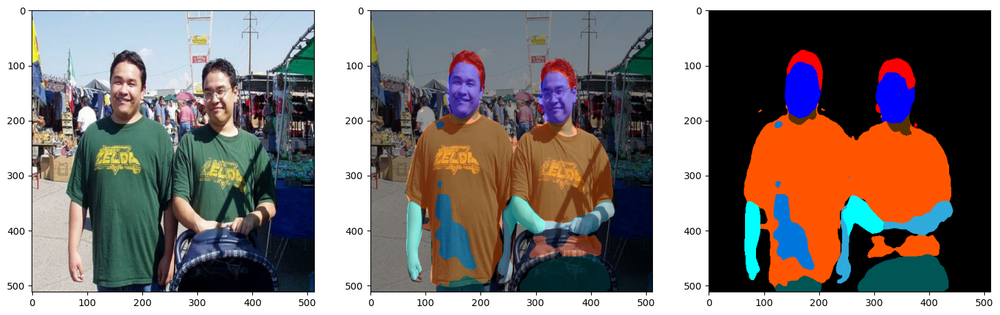

1/1 [==============================] - 1s 824ms/step


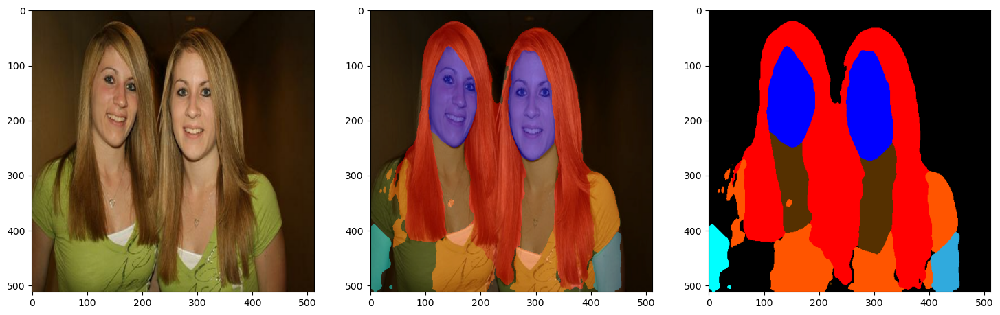

In [35]:
plot_predictions(prediction_paths, colormap, model=model)